<a href="https://colab.research.google.com/github/nicolai5965/Gray-Scott-Reaction-Diffusion-System-Simulation/blob/main/Simulating_Turing_Patterns_in_the_Gray_Scott_Model_using_Explicit_Euler_Method_and_Spectral_Method.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt 
import time
from numba import njit
from tqdm.notebook import trange , tqdm
from IPython.display import display, Latex
from scipy import linalg
from scipy.sparse.linalg import spsolve
import scipy
import matplotlib.animation as animation
from IPython.display import HTML

### I start by setting up the environment:

In [ ]:
# Function for the Explicit Euler Method (EEM) implementation
@njit
def EEM(N, D_A, D_B, f, k, dt, time_steps, dx):
    time_serie = np.arange(0, time_steps, dt)
    A_grid = np.zeros((N, N))
    B_grid = np.zeros((N, N))
    ran_num_x = N // 2
    ran_num_y = N // 2
    A_grid[:] = 1
    B_grid[:] = 0 
    B_grid[ran_num_x-1:ran_num_x+2, ran_num_y-1:ran_num_y+2] = 1
    
    A =  np.zeros((len(time_serie)//100, N, N))
    B =  np.zeros((len(time_serie)//100, N, N))
    
    A_new = np.zeros((N, N))
    B_new = np.zeros((N, N))
    for t in range(len(time_serie)-1):
        for i in range(N):
            for j in range(N):
                    laplacian_A = (A_grid[(i+1)%N, j] + A_grid[(i-1), j] + A_grid[i, (j-1)] + A_grid[i, (j+1)%N] - 4 * A_grid[i, j]) / dx**2
                    laplacian_B = (B_grid[(i+1)%N, j] + B_grid[(i-1), j] + B_grid[i, (j-1)] + B_grid[i, (j+1)%N] - 4 * B_grid[i, j]) / dx**2
                    A_new[i, j] = A_grid[i, j] + ((D_A * laplacian_A) - (A_grid[i, j] * B_grid[i, j]**2) + (f * (1 - A_grid[i, j]))) * dt
                    B_new[i, j] = B_grid[i, j] + ((D_B * laplacian_B) + (A_grid[i, j] * B_grid[i, j]**2) - (B_grid[i, j] * (k + f))) * dt
        if t%100 == 0:
            B[t//100] = B_new
            A[t//100] = A_new
        A_grid = A_new
        B_grid = B_new
    return B , A

CPU times: user 45.7 ms, sys: 6.01 ms, total: 51.7 ms
Wall time: 51.7 ms


In [ ]:
# Function for the spectral method implementation
def spectral(N, dt, A, B, c1, c2, cA, cB):
    
    fA = np.fft.rfft2(A)
    fB = np.fft.rfft2(B)
    fAB2 = np.fft.rfft2(dt*A*B**2)
    fc1dt = np.fft.rfft2(c1*np.ones(A.shape)*dt)
    fg = fA - fAB2 + fc1dt
    kx = 2*np.pi*np.fft.rfftfreq(N, 2)
    ky = 2*np.pi*np.fft.fftfreq(N, 2)
    kx, ky = np.meshgrid(kx, ky)
    Au = fg/(1+cA*(kx**2+ky**2)*dt + c1 * dt)
    fAu = np.fft.irfft2(Au)
    fp = fB + fAB2
    Bu = fp/(1+dt*(cB*(kx**2+ky**2) + c1 + c2))
    fBu = np.fft.irfft2(Bu)
    return fAu, fBu

In [ ]:
%%time
N, D_A, D_B, f, k, dt, dx, timesteps = [100, 2.0, 0.5, 0.055, 0.062, 0.5, 2, 10**4]
# Function to run the spectral method simulation
def spectral_run(N, D_A, D_B, f, k, dt, dx, timesteps):
    Ai = np.ones((N, N))
    Bi = np.zeros((N, N))
    middel = N//2
    Bi[middel-1: middel+2, middel-1: middel+2] = 1
    time = np.arange(0, timesteps, dt)
    glst = []
    f1 = Ai
    f2 = Bi
    for i in time:
        f1, f2 = spectral(N, dt, f1, f2, f, k, D_A, D_B)
        glst.append((f1, f2))
    return glst
glst = spectral_run(N, D_A, D_B, f, k, dt, dx, timesteps)
A_spectral_list , B_spectral_list = glst[0], glst[1]

CPU times: user 33.4 s, sys: 6.69 s, total: 40.1 s
Wall time: 46.8 s


In [ ]:
%%time
N, D_A, D_B, f, k, dt, dx, timesteps = [100, 2.0, 0.5, 0.055, 0.062, 0.5, 2, 10**4]
B_EEM_list , A_EEM_list = EEM(N, D_A, D_B, f, k, dt, timesteps, dx)

CPU times: user 5.86 s, sys: 53.7 ms, total: 5.92 s
Wall time: 5.91 s


In [ ]:
print(np.array(glst).shape)

(20000, 2, 100, 100)


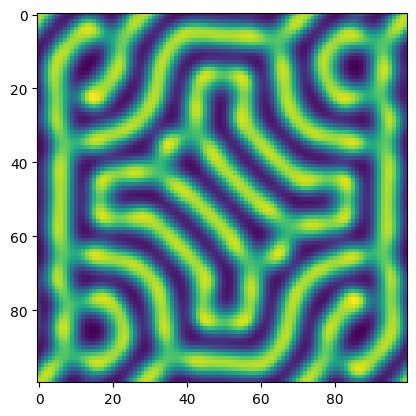

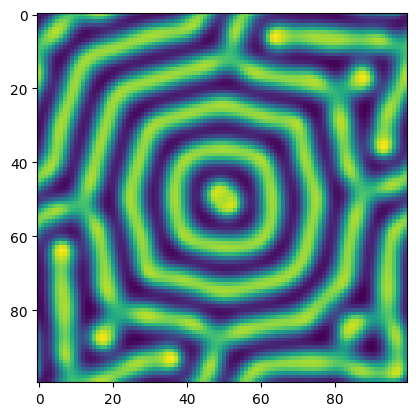

In [ ]:
plt.figure(0)
plt.imshow(glst[-1][-1])
plt.figure(1)
plt.imshow(B_EEM_list[-1])

In [ ]:
N, D_A, D_B, f, k, dt, dx, timesteps = [100, 2.0, 0.5, 0.055, 0.062, 0.5, 2, 10**4]

glst = spectral_run(N, D_A, D_B, f, k, dt, dx, timesteps)
B_list , A_list = EEM(N, D_A, D_B, f, k, dt, timesteps, dx)


  0%|          | 0/200 [00:00<?, ?it/s]

CPU times: user 20.1 s, sys: 255 ms, total: 20.3 s
Wall time: 20.3 s


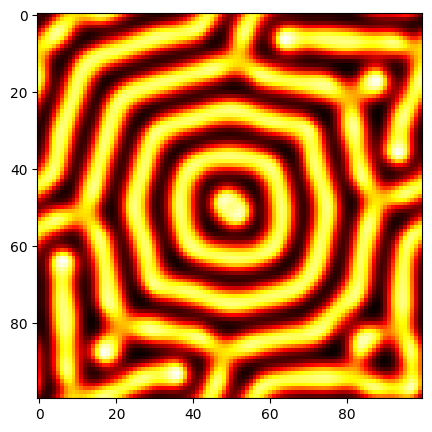

In [ ]:
%%time

fig = plt.figure(figsize=(5, 5))
ims = []
for i in trange(len(B_list)):
    im = plt.imshow(B_list[i], animated=True, cmap="hot")
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=85, blit=True, repeat_delay=1000)

HTML(ani.to_jshtml())

CPU times: user 27.5 s, sys: 260 ms, total: 27.7 s
Wall time: 29.3 s


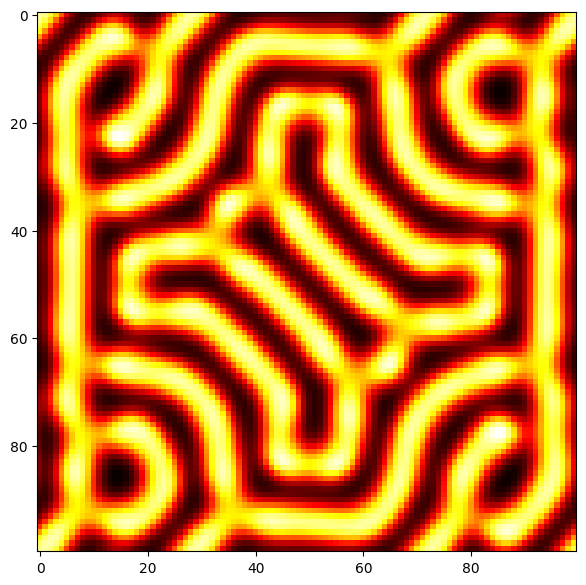

In [ ]:
%%time

fig = plt.figure(figsize=(7, 7))
ims = []
for i in range(0, len(glst), 100):
    im = plt.imshow(glst[i][1], animated=True, cmap="hot")
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=85, blit=True, repeat_delay=1000)

HTML(ani.to_jshtml())

In [ ]:
%%time
# Here is some extra funny parameters. 
#N, D_A, D_B, f, k, dt, dx, timesteps = [100, 2.0, 0.5, 0.055, 0.062, 0.5, 2, 10**4] #normal
N , D_A, D_B, f, k, dt, dx, timesteps = [100, 1.0, 0.5, 0.03, 0.06, 0.5, 2, 10**4]# Smilly
#N , D_A, D_B, f, k, dt, dx, timesteps = [100, 1.0, 0.2, 0.03, 0.06, 0.5, 2, 10**4]# bubbles
#N , D_A, D_B, f, k, dt, dx, timesteps = [100, 0.7, 0.4, 0.03, 0.06, 0.5, 2, 10**4]# 
#N , D_A, D_B, f, k, dt, dx, timesteps = [100, 0.755, 0.32, 0.038, 0.06, 0.5, 2, 10**4] #
#N , D_A, D_B, f, k, dt, dx, timesteps = [100, 0.755, 0.32, 0.038, 0.054, 0.5, 2, 10**4] #

glst = spectral_run(N, D_A, D_B, f, k, dt, dx, timesteps)
B_list , A_list = EEM(N, D_A, D_B, f, k, dt, timesteps, dx)

CPU times: user 33.2 s, sys: 154 ms, total: 33.4 s
Wall time: 33.8 s


  0%|          | 0/200 [00:00<?, ?it/s]

CPU times: user 19.6 s, sys: 225 ms, total: 19.9 s
Wall time: 19.9 s


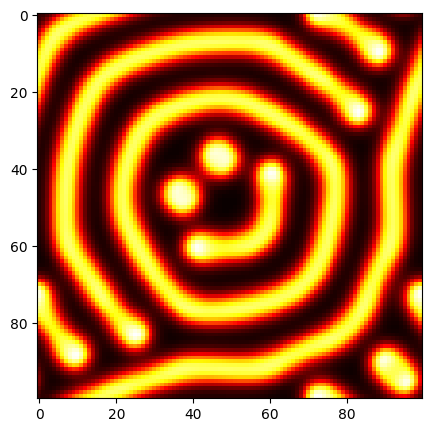

In [ ]:
%%time

fig = plt.figure(figsize=(5, 5))
ims = []
for i in trange(len(B_list)):
    im = plt.imshow(B_list[i], animated=True, cmap="hot")
    ims.append([im])
    #plt.colorbar()

ani = animation.ArtistAnimation(fig, ims, interval=85, blit=True, repeat_delay=1000)

HTML(ani.to_jshtml())

CPU times: user 27.1 s, sys: 214 ms, total: 27.3 s
Wall time: 27.6 s


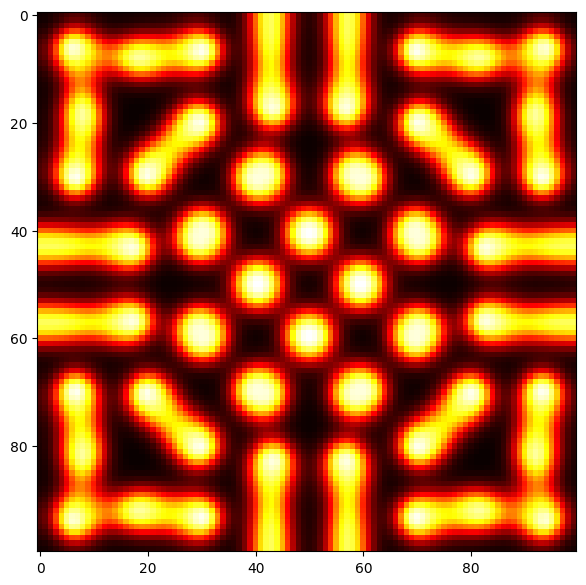

In [ ]:
%%time

fig = plt.figure(figsize=(7, 7))
ims = []
for i in range(0, len(glst), 100):
    im = plt.imshow(glst[i][1], animated=True, cmap="hot")
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=85, blit=True, repeat_delay=1000)

HTML(ani.to_jshtml())